# importing all libraries

In [1]:
import os
import re
import sys
import nltk
import itertools
import numpy as np 
import pandas as pd 
import seaborn as sns
from sklearn import tree
from sklearn.svm import SVC
from joblib import dump, load
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from tensorflow.keras.models import Sequential, Model
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.naive_bayes import MultinomialNB
from sklearn.preprocessing import LabelEncoder
from keras.utils.np_utils import to_categorical
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from keras.layers import Dense,LSTM, SpatialDropout1D, Embedding

# Reading the Dataset

In [2]:
df = pd.read_csv('Resumedataset.csv')
df

,Category,Resume
0,Data Science,Skills * Programming Languages: Python (pandas...
1,Data Science,Education Details \r\nMay 2013 to May 2017 B.E...
2,Data Science,"Areas of Interest Deep Learning, Control Syste..."
3,Data Science,Skills â¢ R â¢ Python â¢ SAP HANA â¢ Table...
4,Data Science,"Education Details \r\n MCA YMCAUST, Faridab..."
...,...,...
957,Testing,Computer Skills: â¢ Proficient in MS office (...
958,Testing,â Willingness to accept the challenges. â ...
959,Testing,"PERSONAL SKILLS â¢ Quick learner, â¢ Eagerne..."
960,Testing,COMPUTER SKILLS & SOFTWARE KNOWLEDGE MS-Power ...


# List of all Categories

In [3]:
for i in range(len(df['Category'].unique())):
    print(df['Category'].unique()[i])

Data Science
HR
Advocate
Arts
Web Designing
Mechanical Engineer
Sales
Health and fitness
Civil Engineer
Java Developer
Business Analyst
SAP Developer
Automation Testing
Electrical Engineering
Operations Manager
Python Developer
DevOps Engineer
Network Security Engineer
PMO
Database
Hadoop
ETL Developer
DotNet Developer
Blockchain
Testing


# Visualizing most commonly used words in each type of Resumes

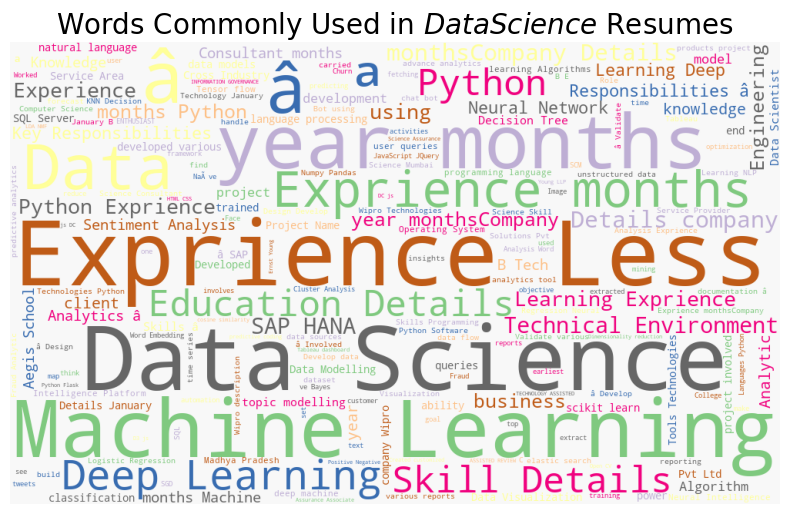

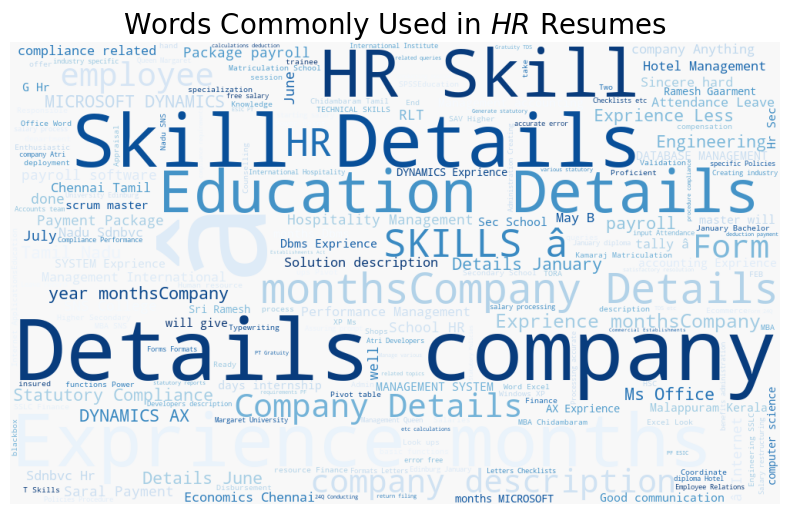

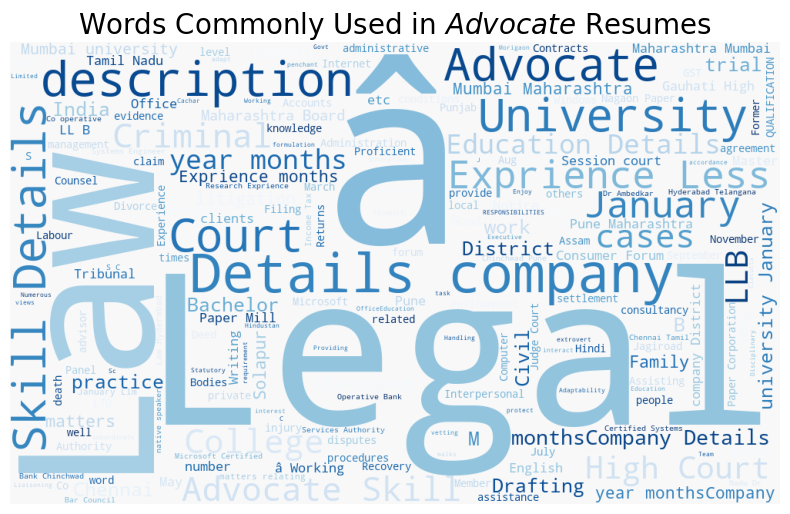

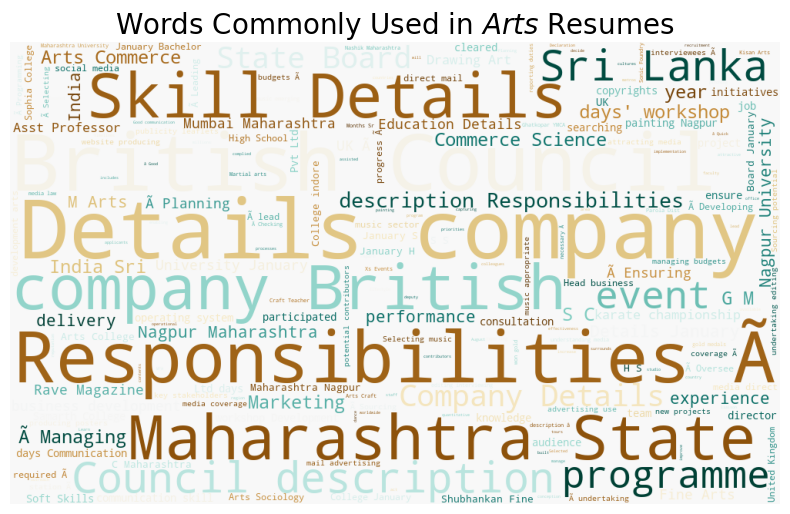

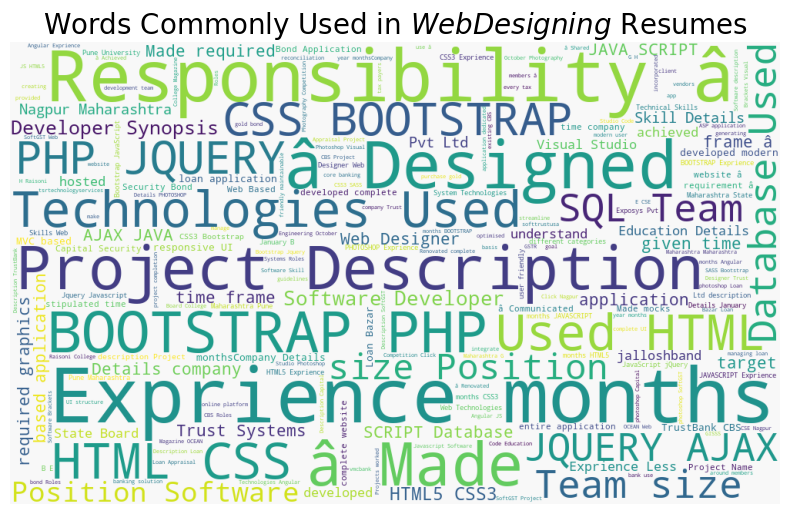

...

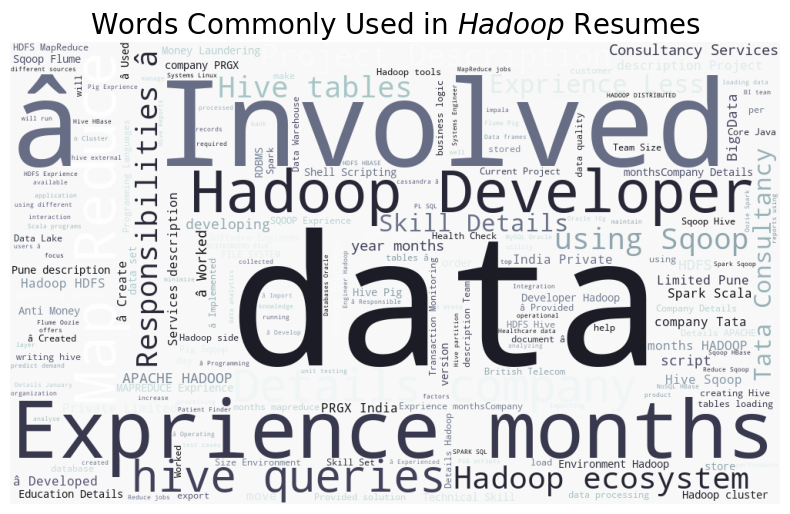

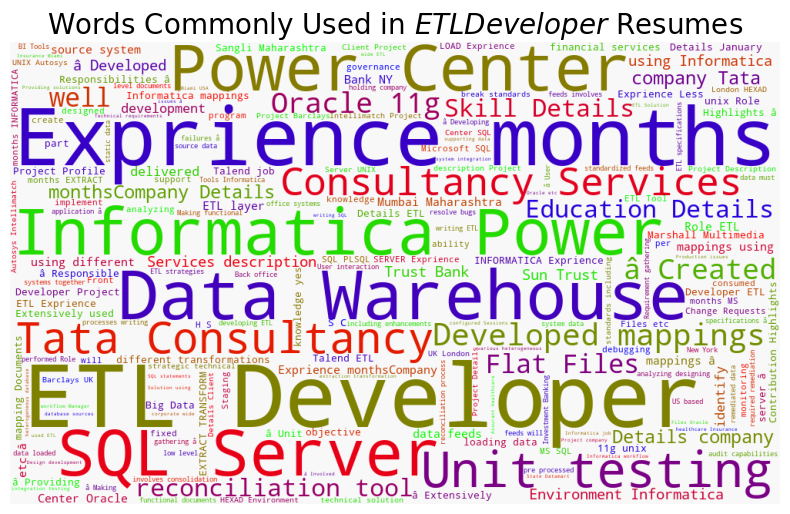

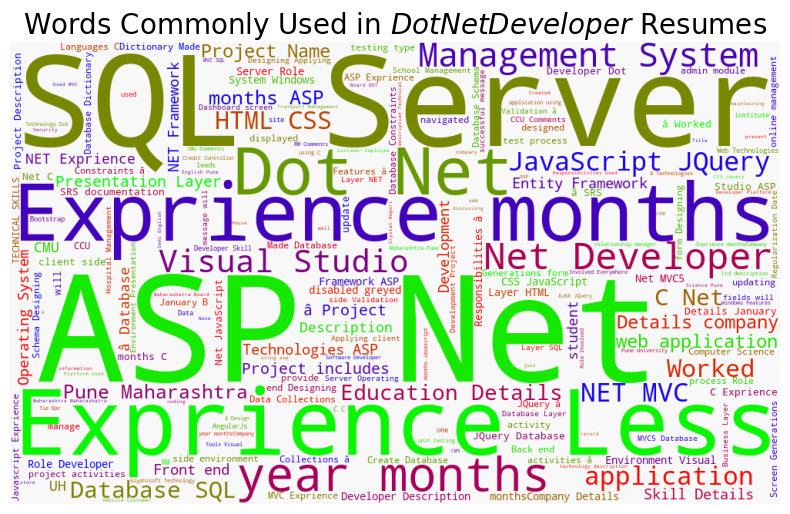

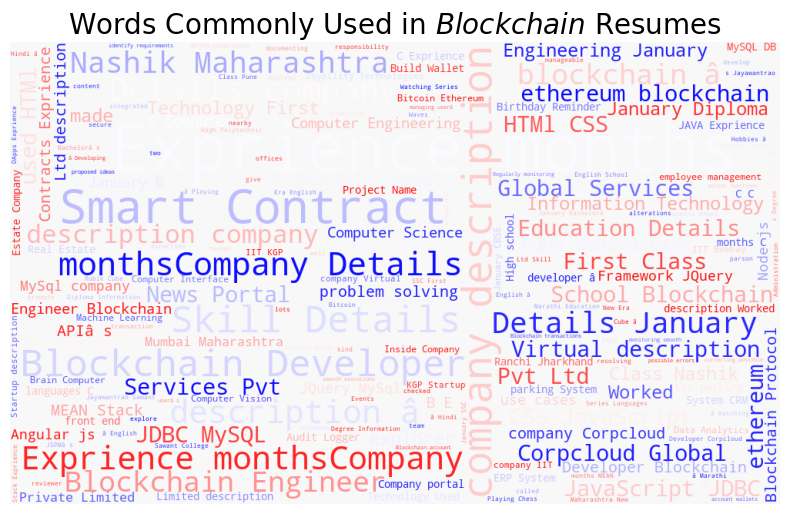

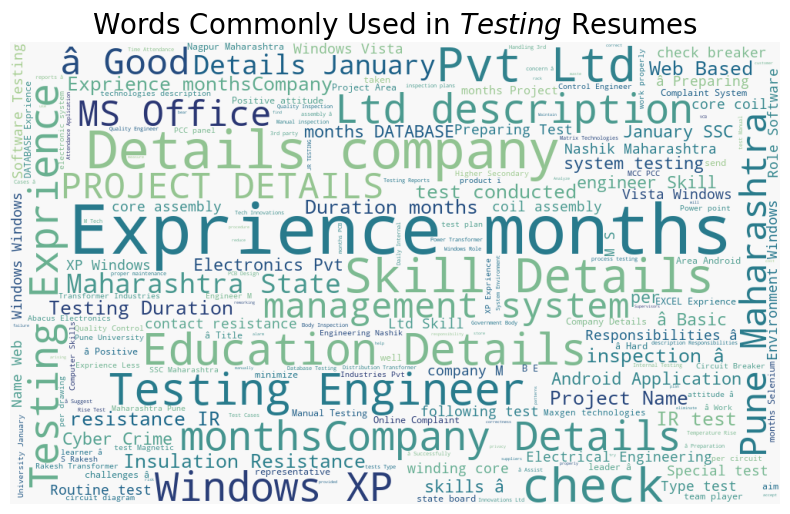

In [4]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

# Pre Processing

# Checking for missing data

In [5]:
print(df.isnull().sum())

Category    0
Resume      0
dtype: int64


# Converting the data into lower case and removing words with small lengths

In [6]:
def process_resume(text):
    text = text.lower()
    words = text.split()
    filtered_words = [word for word in words if len(word) > 3]
    return ' '.join(filtered_words)

df['Resume'] = df['Resume'].apply(process_resume)
print(df['Resume'].head())

0    skills programming languages: python (pandas, ...
1    education details 2013 2017 uit-rgpv data scie...
2    areas interest deep learning, control system d...
3    skills python hana tableau hana hana lumira li...
4    education details ymcaust, faridabad, haryana ...
Name: Resume, dtype: object


# removing punctuations

In [7]:
ps = list(";?.:!,")
df['Resume'] = df['Resume']

for p in ps:   
    df['Resume'] = df['Resume'].str.replace(p, '')

# Removing '\n' and '\t', extra spaces, quoting text and progressive pronouns

In [8]:
df['Resume'] = df['Resume'].str.replace("  ", " ", regex=False) 
df['Resume'] = df['Resume'].str.replace("'", "", regex=False)  
df['Resume'] = df['Resume'].str.replace('\t', ' ', regex=False)
df['Resume'] = df['Resume'].str.replace('"', '', regex=False)  
df['Resume'] = df['Resume'].str.replace('\n', ' ', regex=False) 
pronouns_to_remove = r'\b(i|me|my|mine|myself|we|our|ours|ourselves)\b'
df['Resume'] = df['Resume'].str.replace(pronouns_to_remove, '', regex=True)
df['Resume'] = df['Resume'].str.replace("  ", " ", regex=False)

# Applying Lemmatization

In [9]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
import nltk
nltk.download('punkt_tab')
import nltk
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\anish\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\anish\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\anish\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\anish\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\anish\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [10]:
import nltk
import os
expected_path = os.path.join(nltk.data.path[0], 'taggers', 'averaged_perceptron_tagger', 'averaged_perceptron_tagger.zip')
print(f"Checking for resource at: {expected_path}")
print(f"Does the file exist? {os.path.exists(expected_path)}")

Checking for resource at: C:\Users\anish/nltk_data\taggers\averaged_perceptron_tagger\averaged_perceptron_tagger.zip
Does the file exist? False


In [11]:
import nltk
nltk.download('averaged_perceptron_tagger')
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
from nltk.tag import pos_tag
from nltk.corpus import wordnet

lemmatizer = WordNetLemmatizer()

# Explicitly initialize the POS tagger (though it should happen automatically)
try:
    pos_tag(['example', 'text'])
except LookupError as e:
    print(f"Error initializing POS tagger: {e}")

def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN  # Default to noun

def lemmatize_text(text):
    tokens = word_tokenize(text)
    tagged_tokens = pos_tag(tokens)
    lemmatized_words = []
    for word, tag in tagged_tokens:
        wordnet_tag = get_wordnet_pos(tag)
        try:
            lemmatized_words.append(lemmatizer.lemmatize(word, pos=wordnet_tag))
        except LookupError as e:
            print(f"LookupError during lemmatization: '{word}', tag: '{tag}', wordnet_tag: '{wordnet_tag}' - {e}")
            lemmatized_words.append(lemmatizer.lemmatize(word)) # Lemmatize without POS as fallback
    return " ".join(lemmatized_words)

df['Resume'] = df['Resume'].apply(lemmatize_text)
print(df['Resume'].head())

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\anish\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


0    skill program language python ( pandas numpy s...
1    education detail 2013 2017 uit-rgpv data scien...
2    area interest deep learn control system design...
3    skill python hana tableau hana hana lumira lin...
4    education detail ymcaust faridabad haryana dat...
Name: Resume, dtype: object


# Removing Stop-words

In [12]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\anish\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [13]:
sw = list(stopwords.words('english'))
for s in sw:
    rs = r"\b" + s + r"\b"
    df['Resume'] = df['Resume'].str.replace(rs, '')

# Visualizing most commonly used words in Resumes after applying NLP techniques 

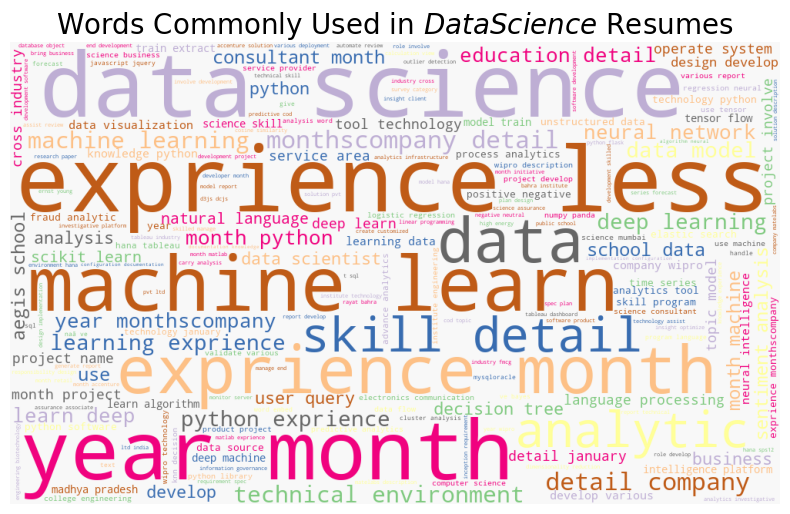

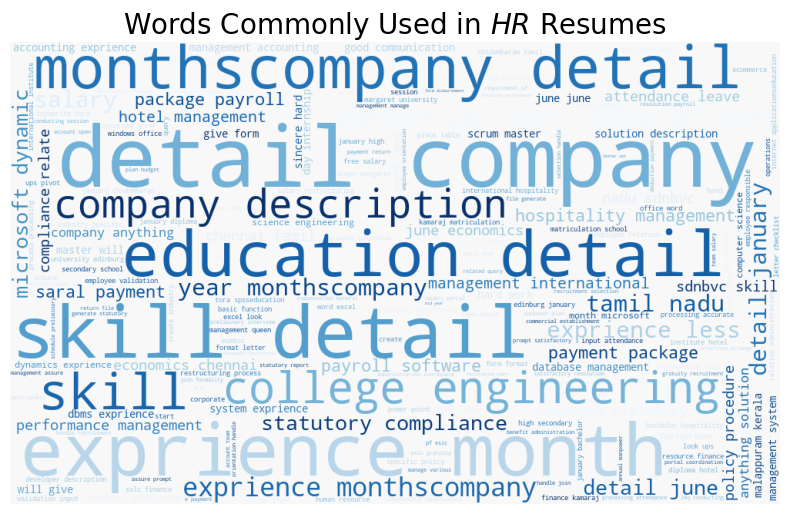

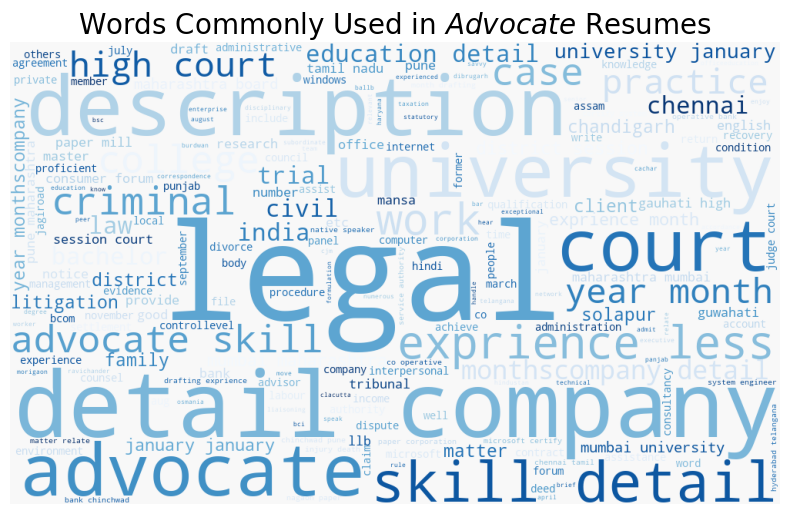

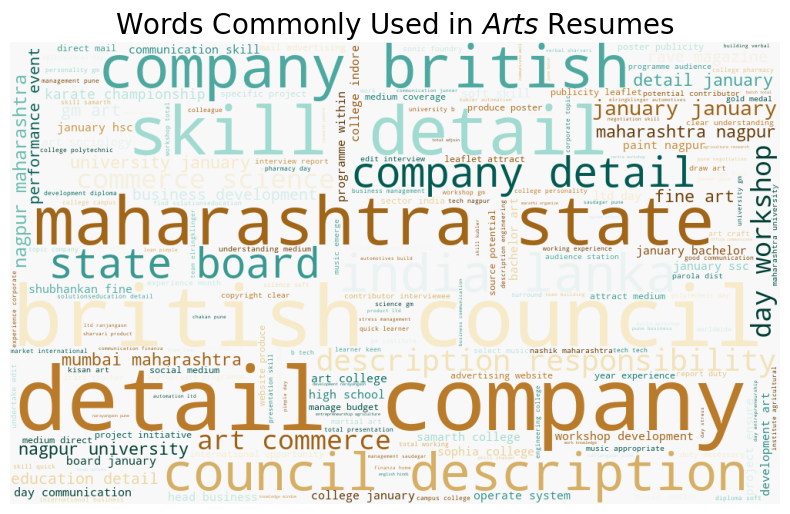

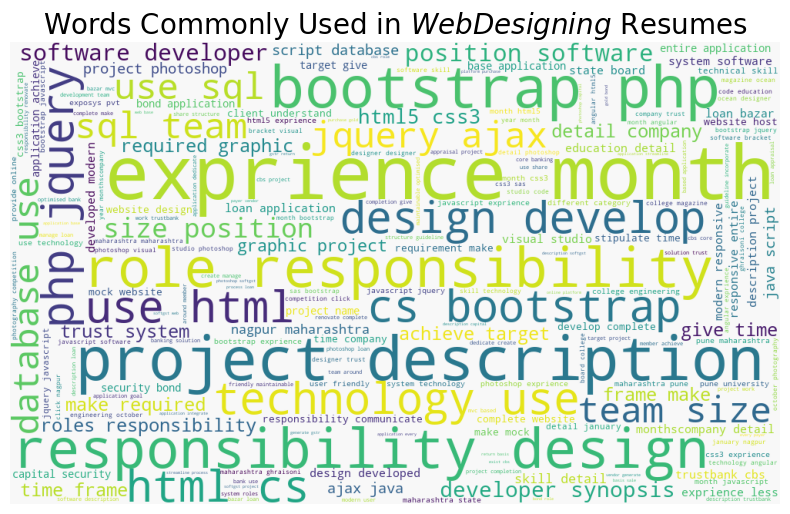

...

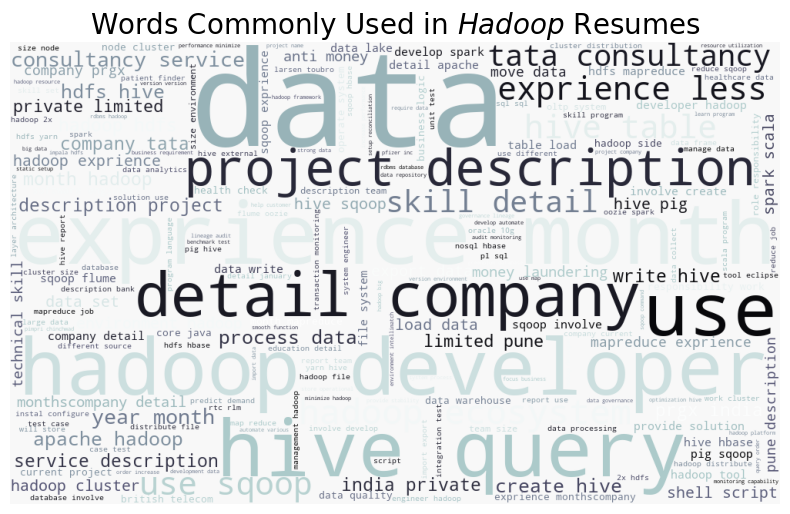

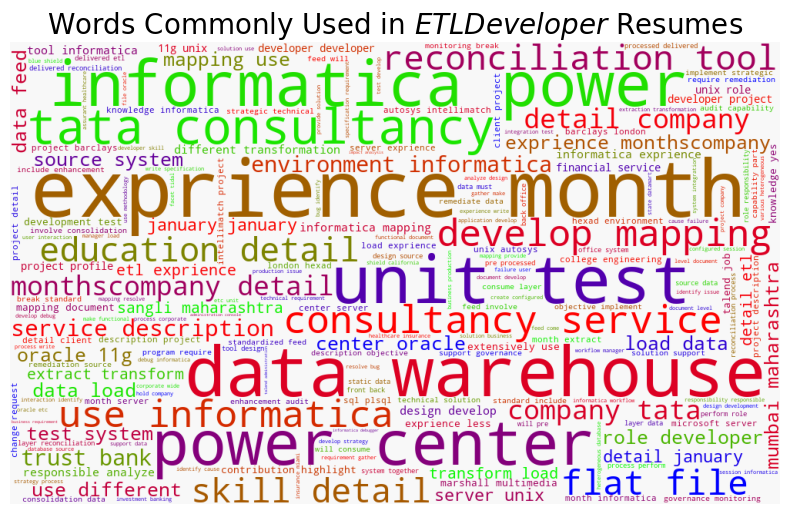

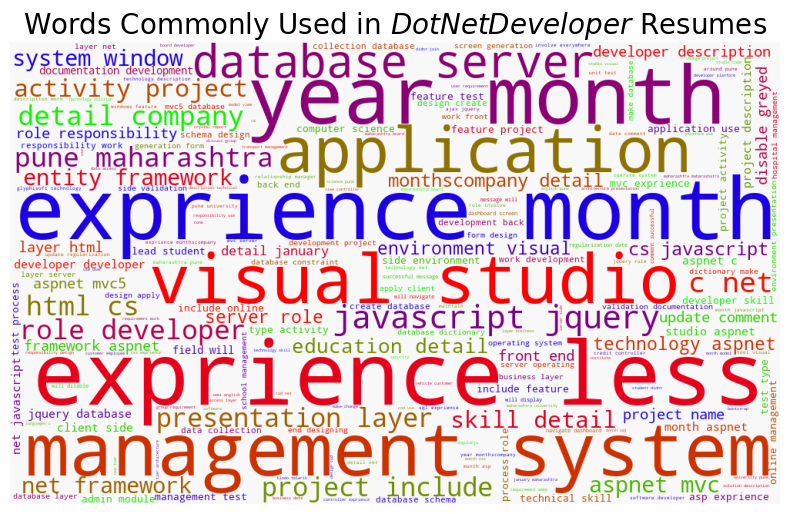

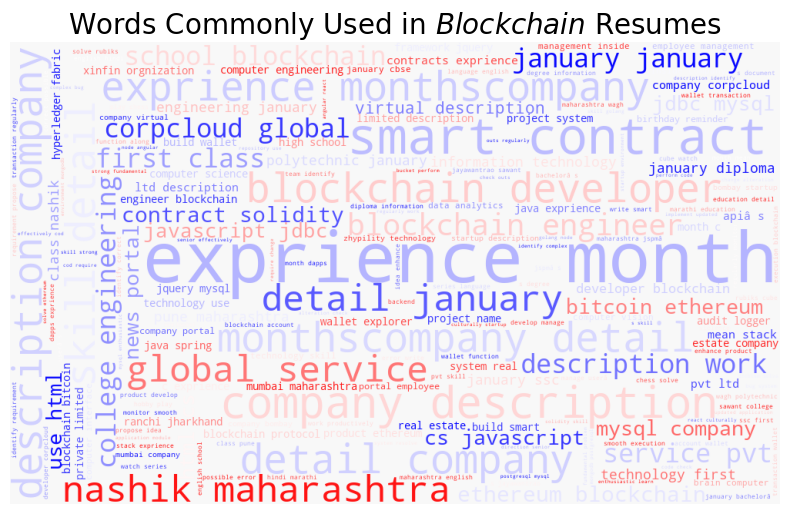

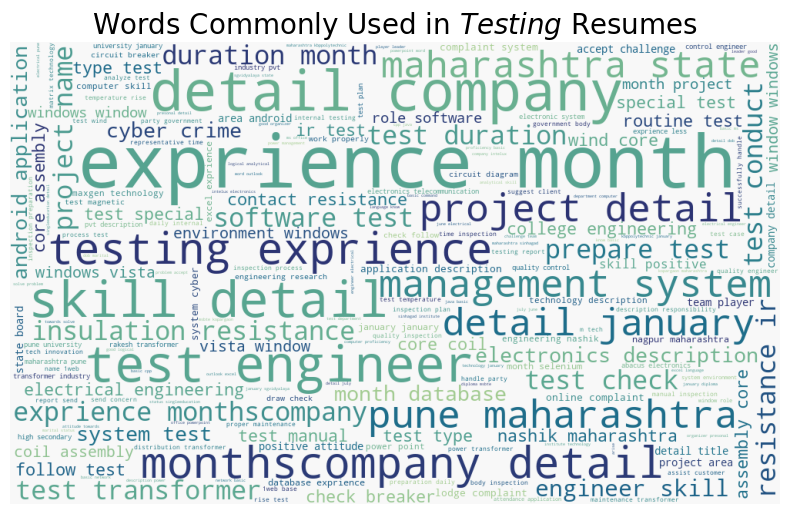

In [14]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r','Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

In [15]:
df.iloc[1,1]

'education detail 2013 2017 uit-rgpv data scientist data scientist matelabs skill detail python- exprience less than year month statsmodels- exprience month aws- exprience less than year month machine learning- exprience less than year month sklearn- exprience less than year month scipy- exprience less than year month keras- exprience less than year monthscompany detail company matelabs description platform business professional dummy enthusiasts 60/a koramangala block achievements/tasks behind sukh sagar bengaluru india develop deployed auto preprocessing step machine learn mainly miss value treatment outlier detection encode scaling feature selection dimensionality reduction deploy automate classification regression model linkedincom/in/aditya-rathore- b4600b146 reasearch deploy time series forecast model arima sarimax holt-winter prophet work meta-feature extracting problem githubcom/rathorology implement state research paper outlier detection mixed attribute company matelabs descri

# Data Preparation for Training and Testing

# Encoding Labels

In [16]:
c = LabelEncoder()
df['Category'] = c.fit_transform(df['Category'])
le_name_mapping = dict(zip( c.transform(c.classes_),c.classes_))
print(le_name_mapping)

{0: 'Advocate', 1: 'Arts', 2: 'Automation Testing', 3: 'Blockchain', 4: 'Business Analyst', 5: 'Civil Engineer', 6: 'Data Science', 7: 'Database', 8: 'DevOps Engineer', 9: 'DotNet Developer', 10: 'ETL Developer', 11: 'Electrical Engineering', 12: 'HR', 13: 'Hadoop', 14: 'Health and fitness', 15: 'Java Developer', 16: 'Mechanical Engineer', 17: 'Network Security Engineer', 18: 'Operations Manager', 19: 'PMO', 20: 'Python Developer', 21: 'SAP Developer', 22: 'Sales', 23: 'Testing', 24: 'Web Designing'}


# Using TFIDF approach for converting the content in Resumes into vector form

In [17]:
from sklearn.feature_extraction.text import TfidfVectorizer
cv = TfidfVectorizer(max_features=20000)
X = cv.fit_transform(df['Resume'])
y = df['Category']

In [18]:
a = cv.get_feature_names_out()

In [19]:
import pickle
filename = 'cv.pickle'
#pickle.dump('cv.pickle',a)
#pickle.dump(cv, open(filename, 'wb'))

In [20]:
X.shape,y.shape

((962, 6276), (962,))

In [21]:
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import NearMiss
smk = SMOTETomek(random_state=42)
X_res,y_res=smk.fit_resample(X,df['Category'])

C:\Users\anish\resume-screening-main\tf_env_39\lib\site-packages\sklearn\base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
C:\Users\anish\resume-screening-main\tf_env_39\lib\site-packages\sklearn\base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
C:\Users\anish\resume-screening-main\tf_env_39\lib\site-packages\sklearn\base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


In [22]:
X_res.shape,y_res.shape

((2100, 6276), (2100,))

# Splitting the Data using Stratified split

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size = 0.25, stratify=y_res, random_state = 42)

In [24]:
X_train.shape,y_train.shape

((1575, 6276), (1575,))

In [25]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                              cmap=plt.cm.Greens):
    plt.figure(figsize=(50, 20), dpi=130)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [26]:
print(X_test[0].shape)

(1, 6276)


# Using KNeighbors Classifier as the Model and printing evaluating it using confusion matrix

In [27]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
model1=KNeighborsClassifier()
clf1=GridSearchCV(model1,{'n_neighbors':[1,2,3,4,5,6,7,8,9,10]})
clf1.fit(X_res,y_res)
clf1.cv_results_

{'mean_fit_time': array([0.00652761, 0.00625038, 0.00937481, 0.        , 0.00312452,
        0.00624943, 0.00412488, 0.00312452, 0.00936956, 0.0062489 ]),
 'std_fit_time': array([0.00744644, 0.00765512, 0.0076545 , 0.        , 0.00624905,
        0.00765395, 0.00606606, 0.00624905, 0.00765022, 0.00765331]),
 'mean_score_time': array([0.07234273, 0.07611847, 0.07187505, 0.08579082, 0.08125067,
        0.07943201, 0.07772379, 0.08125286, 0.07308407, 0.07812486]),
 'std_score_time': array([0.00712178, 0.00765733, 0.00765703, 0.01210591, 0.00625647,
        0.00261607, 0.00701109, 0.00625406, 0.00646058, 0.01397015]),
 'param_n_neighbors': masked_array(data=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
              mask=[False, False, False, False, False, False, False, False,
                    False, False],
        fill_value=999999),
 'params': [{'n_neighbors': 1},
  {'n_neighbors': 2},
  {'n_neighbors': 3},
  {'n_neighbors': 4},
  {'n_neighbors': 5},
  {'n_neighbors': 6},
  {'n_neighbors': 7},
  

In [28]:
pd1=pd.DataFrame(clf1.cv_results_)
pd1.to_csv('Knn.csv')

In [29]:
clf1 = KNeighborsClassifier(n_neighbors=1)
clf1 = clf1.fit(X_train, y_train)
yp = clf1.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)


accuracy is:  1.0


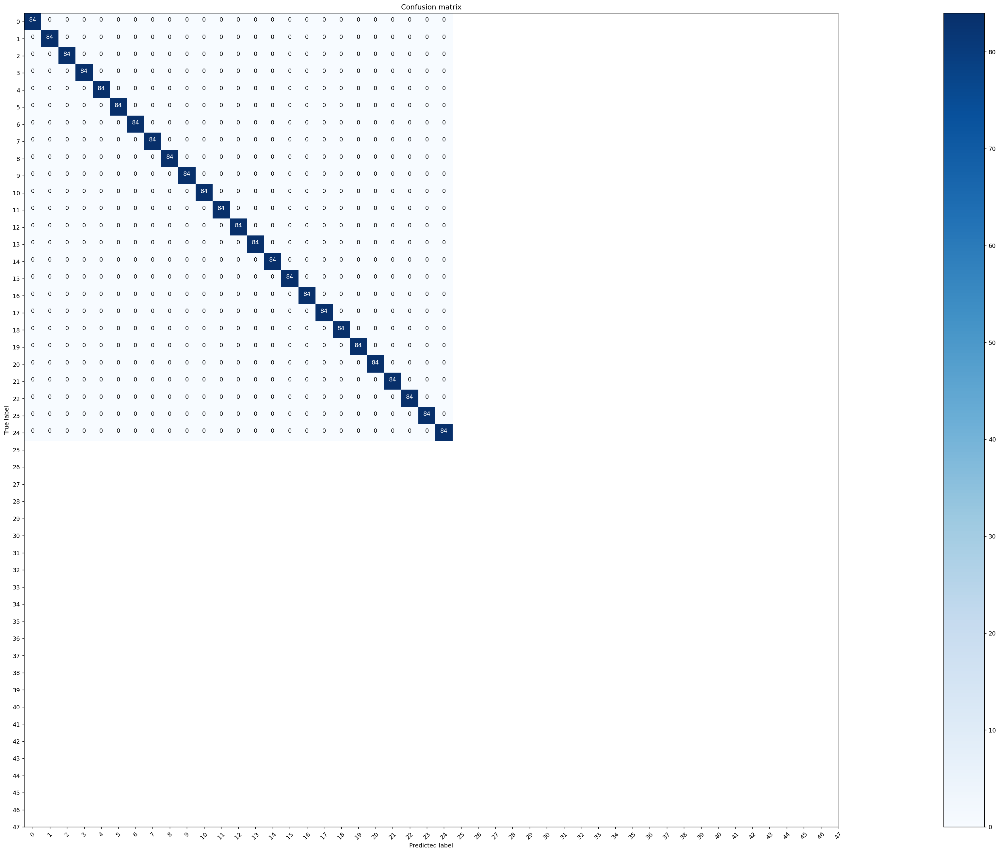

In [30]:
yc = clf1.predict(X_res)
CM = confusion_matrix(y_res, yc)
plot_confusion_matrix(CM, classes = range(48),cmap=plt.cm.Blues)
#dump(clf1, 'knei.joblib') 

In [31]:
from sklearn.metrics import precision_recall_fscore_support
s1 = precision_recall_fscore_support(y_res, yc,average='weighted')
s1

(1.0, 1.0, 1.0, None)

# Using Decision tree as the Model and printing evaluating it using confusion matrix

In [32]:
from sklearn.tree import DecisionTreeClassifier
model2=DecisionTreeClassifier()
clf2=GridSearchCV(model2,{'max_depth':[10,20,30,40,50,60,70,80,90,100]},cv=5)
clf2.fit(X_res,y_res)
clf2.cv_results_

{'mean_fit_time': array([0.21898499, 0.3219676 , 0.32832012, 0.3314404 , 0.3283577 ,
        0.32851324, 0.32797518, 0.32821832, 0.32497649, 0.33768487]),
 'std_fit_time': array([0.01578393, 0.01794994, 0.01941991, 0.01822152, 0.0195887 ,
        0.01935889, 0.02573414, 0.02243958, 0.01888665, 0.02237188]),
 'mean_score_time': array([0.        , 0.00312538, 0.00625119, 0.00625114, 0.00625091,
        0.00937576, 0.00624719, 0.006251  , 0.00937915, 0.00625129]),
 'std_score_time': array([0.        , 0.00625076, 0.00765612, 0.00765606, 0.00765577,
        0.00765528, 0.00765121, 0.00765588, 0.00765804, 0.00765623]),
 'param_max_depth': masked_array(data=[10, 20, 30, 40, 50, 60, 70, 80, 90, 100],
              mask=[False, False, False, False, False, False, False, False,
                    False, False],
        fill_value=999999),
 'params': [{'max_depth': 10},
  {'max_depth': 20},
  {'max_depth': 30},
  {'max_depth': 40},
  {'max_depth': 50},
  {'max_depth': 60},
  {'max_depth': 70},
 

In [33]:
pd2=pd.DataFrame(clf2.cv_results_)
pd2.to_csv('DT.csv')

accuracy is:  1.0


['DT.joblib']

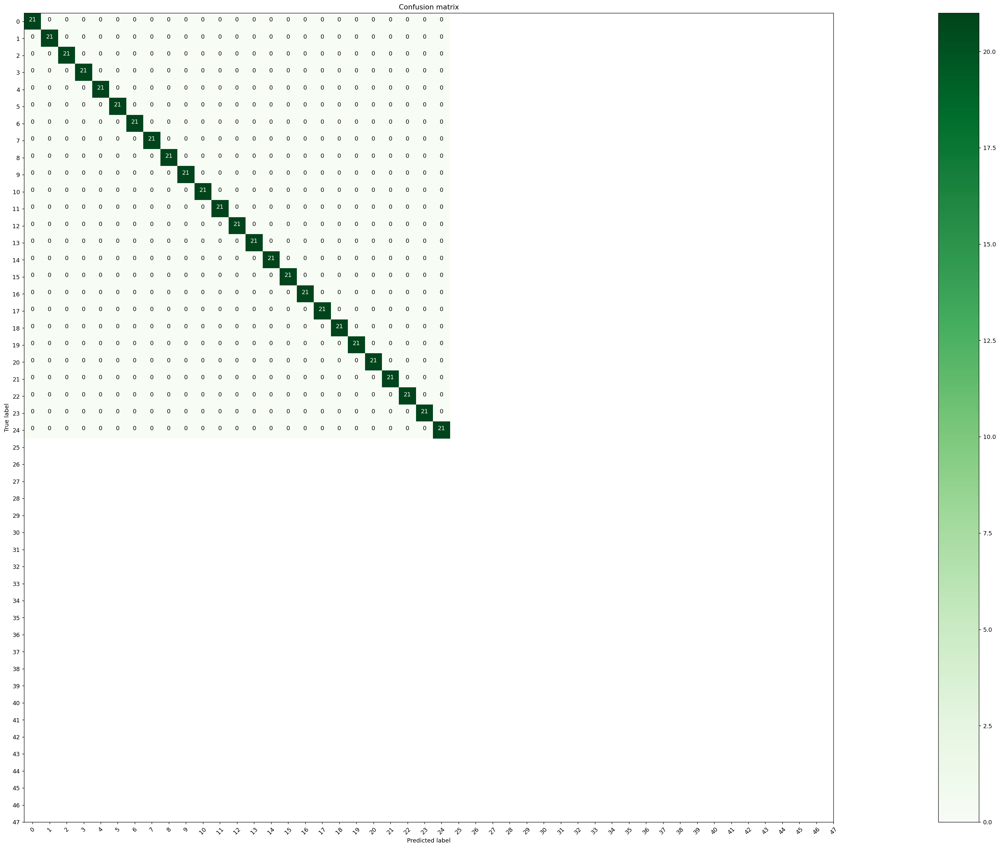

In [34]:
clf2 = tree.DecisionTreeClassifier(max_depth=100)
clf2 = clf2.fit(X_train, y_train)
yp = clf2.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)
CM = confusion_matrix(y_test, yp)
plot_confusion_matrix(CM, classes = range(48))
dump(clf2, 'DT.joblib') 

In [35]:
yp2 = clf2.predict(X_res)

In [36]:
from sklearn.metrics import precision_recall_fscore_support
s2 = precision_recall_fscore_support(y_res, yp2,average='weighted')
s2

(1.0, 1.0, 1.0, None)

In [37]:
from sklearn.ensemble import RandomForestClassifier
model3=RandomForestClassifier()
clf3=GridSearchCV(model3,{'n_estimators':[10,50,100,300,500]},cv=5)
clf3.fit(X_res,y_res)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'n_estimators': [10, 50, 100, 300, 500]})

In [38]:
clf3.best_estimator_

RandomForestClassifier(n_estimators=500)

In [39]:
pd3=pd.DataFrame(clf3.cv_results_)
pd3.to_csv('RF.csv')

In [40]:
clf4=RandomForestClassifier(n_estimators = 500)
clf4 = clf4.fit(X_train, y_train)
yp = clf4.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)
dump(clf4, 'RF.joblib') 

accuracy is:  1.0


['RF.joblib']

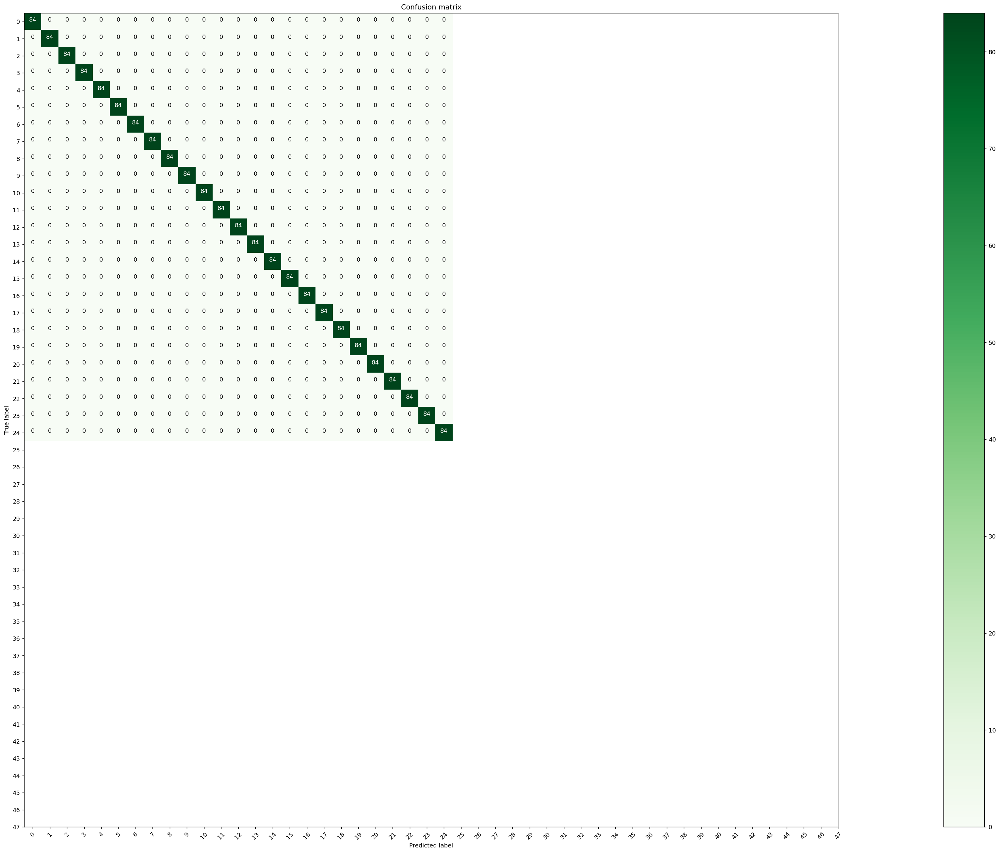

In [41]:
yp4 = clf4.predict(X_res)
CM = confusion_matrix(y_res, yp4)
plot_confusion_matrix(CM, classes = range(48))

In [42]:
from sklearn.metrics import precision_recall_fscore_support
s3 = precision_recall_fscore_support(y_res, yp4,average='weighted')
s3

(1.0, 1.0, 1.0, None)

In [43]:
from sklearn.svm import SVC
model4=SVC()
clf4 = GridSearchCV(model4,{'C':[0.01,0.1,0.5,1],'kernel':['linear','poly','rbf','sigmoid']})
clf4.fit(X_res,y_res)
clf4.cv_results_

{'mean_fit_time': array([6.78159318, 6.62838135, 6.5777658 , 6.65426488, 3.90219679,
        4.51787686, 4.78453832, 4.38350248, 1.15446773, 1.57889032,
        1.40919623, 1.32536311, 0.75651889, 1.15559187, 0.87744312,
        0.83060441]),
 'std_fit_time': array([0.07238493, 0.18788606, 0.18762547, 0.04983439, 0.01551732,
        0.0408219 , 0.05291494, 0.0181228 , 0.01562732, 0.03252445,
        0.02026369, 0.01176128, 0.01205541, 0.03909638, 0.01762377,
        0.00812715]),
 'mean_score_time': array([0.88741736, 0.97098002, 0.92775521, 0.87716455, 0.70719032,
        0.76793823, 0.80537009, 0.77208629, 0.27390494, 0.28445773,
        0.25678153, 0.27248449, 0.18749609, 0.20227103, 0.16874971,
        0.17187405]),
 'std_score_time': array([4.30779767e-02, 1.03897633e-01, 2.31935103e-02, 1.29726831e-02,
        1.12808980e-02, 2.20273402e-02, 1.91466610e-02, 1.15614266e-02,
        1.19332051e-02, 6.20392334e-03, 1.26586809e-02, 1.66325403e-02,
        5.96256219e-06, 1.70055532e-

In [44]:
pd4=pd.DataFrame(clf4.cv_results_)
pd4.to_csv('SVC.csv')

In [45]:
clf4.best_params_

{'C': 0.5, 'kernel': 'linear'}

In [46]:

clf3=SVC(C=1, kernel= 'rbf')
clf3 = clf3.fit(X_train, y_train)
yp = clf3.predict(X_test)
acc = accuracy_score(y_test, yp)
print("accuracy is: ",acc)
dump(clf3, 'SVC.joblib') 



accuracy is:  1.0


['SVC.joblib']

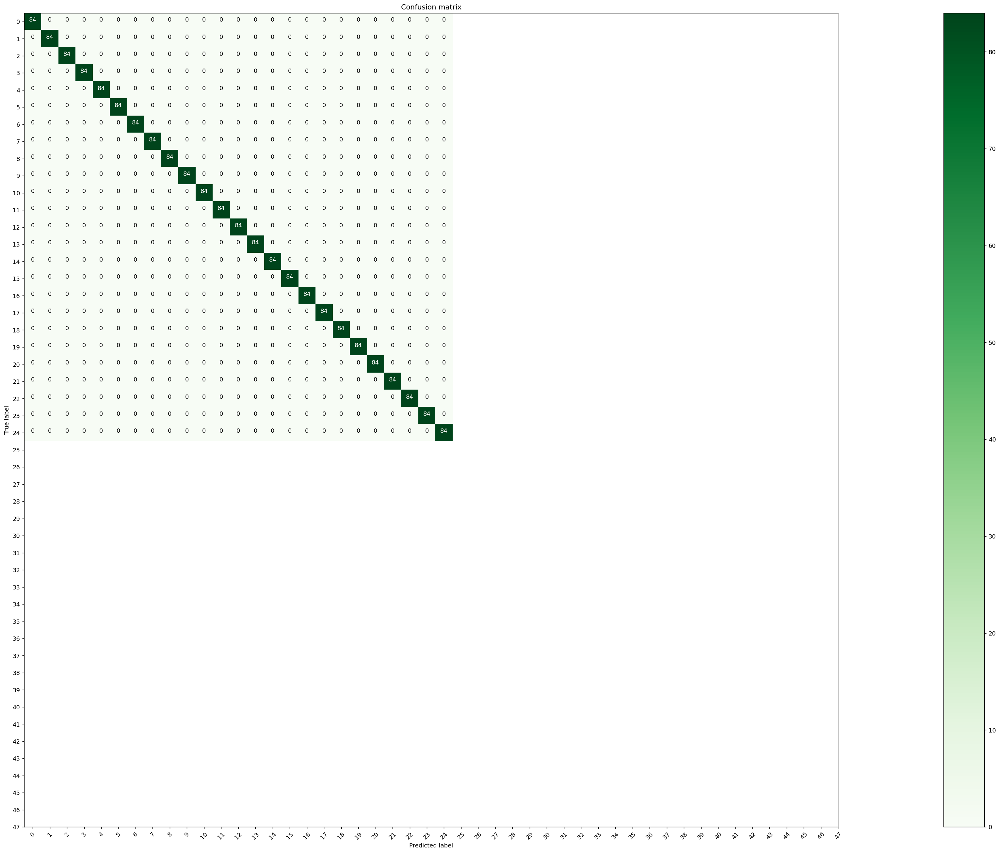

In [47]:
yp3 = clf3.predict(X_res)
CM = confusion_matrix(y_res, yp3)
plot_confusion_matrix(CM, classes = range(48))

In [48]:
from sklearn.metrics import precision_recall_fscore_support
s4 = precision_recall_fscore_support(y_res, yp3,average='weighted')
s4

(1.0, 1.0, 1.0, None)

In [49]:
import xgboost as xgb
xgb_classifier = xgb.XGBClassifier()
xgb_classifier.fit(X_train,y_train)
predictions = xgb_classifier.predict(X_test)
print("Accuracy of Model::",accuracy_score(y_test,predictions))

Accuracy of Model:: 1.0
